In [1]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.neighbors import NearestNeighbors
from sklearn.metrics import precision_score
import pandas as pd
import seaborn as sns
from statsmodels import api as sm
from matplotlib import pyplot as plt
from pandas.plotting import register_matplotlib_converters
import os
import numpy as np
import math
import validate
from sklearn.preprocessing import StandardScaler
import PR_curve
import librosa as lb
import os
import matplotlib.pyplot as plt
import glob
import wave
import IPython
from IPython.display import display
import datetime

In [2]:
data_dir='fixed_csv_label'
df = pd.read_csv( os.path.join(data_dir, 'learning_data_10.csv') )
df=df[df['day']<=9]
df

,original,label,time,day
0,53.4,0,15,0
1,52.8,0,15,0
2,52.8,0,15,0
3,53.2,0,15,0
4,53.6,0,15,0
...,...,...,...,...
3995345,45.9,0,5,9
3995346,45.6,0,5,9
3995347,45.8,0,5,9
3995348,45.7,0,5,9


In [3]:
def make_data(x, str,w):
    x=pd.DataFrame(x)
    window=w
    for i in range(1, window):
        column=f'{str}_lag{i}'
        x[column]=x[str].shift(i)
    return x

def make_label(x, w):
    window=w
    x['label_all']=x['label']
    for i in range(1, window):
        x.loc[(x['label_all']==1)|(x['label'].shift(i)==1), 'label_all']=1
        x.loc[(x['label_all']==0)&(x['label'].shift(i)==0), 'label_all']=0
    
    x['label']=x['label_all']
    return x[['label']]

df_list=[]
for i in set(df['day']):
    lag=[] 
    window=5
    lag.append(make_data(df.loc[df['day']==i, ['original']], 'original', window))
    lag.append(df.loc[df['day']==i, ['day']])
    lag.append(make_label(df.loc[df['day']==i, ['label']], window))
    df_add_lag=pd.concat(lag, axis=1)
    df_list.append(df_add_lag)
df=pd.concat(df_list)
df=df.dropna().reset_index(drop=True)
df

,original,original_lag1,original_lag2,original_lag3,original_lag4,day,label
0,53.6,53.2,52.8,52.8,53.4,0,0
1,54.0,53.6,53.2,52.8,52.8,0,0
2,54.7,54.0,53.6,53.2,52.8,0,0
3,55.7,54.7,54.0,53.6,53.2,0,0
4,55.5,55.7,54.7,54.0,53.6,0,0
...,...,...,...,...,...,...,...
3995305,45.9,45.6,45.4,45.9,46.0,9,0
3995306,45.6,45.9,45.6,45.4,45.9,9,0
3995307,45.8,45.6,45.9,45.6,45.4,9,0
3995308,45.7,45.8,45.6,45.9,45.6,9,0


In [4]:
test_day=[9]
train=df[(df['label']==0)&(~df['day'].isin(test_day))][df.columns[:-2]].reset_index(drop=True)
test=df[(df['day'].isin(test_day))][df.columns[:-2]].reset_index(drop=True)
test

,original,original_lag1,original_lag2,original_lag3,original_lag4
0,46.5,47.0,47.1,47.4,47.7
1,46.2,46.5,47.0,47.1,47.4
2,45.8,46.2,46.5,47.0,47.1
3,46.0,45.8,46.2,46.5,47.0
4,46.2,46.0,45.8,46.2,46.5
...,...,...,...,...,...
413976,45.9,45.6,45.4,45.9,46.0
413977,45.6,45.9,45.6,45.4,45.9
413978,45.8,45.6,45.9,45.6,45.4
413979,45.7,45.8,45.6,45.9,45.6


In [5]:
nk = 10
neigh = NearestNeighbors(n_neighbors=nk)
neigh.fit(train)
d = neigh.kneighbors(test)[0]

d = np.mean(d, axis=1)
mx = np.max(d)
d = d / mx

In [6]:
# 評価用のデータを改めて用意し、異常度を割り当てる
original = pd.read_csv( os.path.join(data_dir, 'learning_data_10.csv') )
test_v=original[original['day'].isin(test_day)][['original', 'label']].reset_index(drop=True)
test_v['d']=d[0]
test_v.loc[window-1:, 'd']=d
d=test_v['d'].values

## 評価

In [7]:
thr_df=pd.read_csv('day_thr.csv')
thr_df

,day,thr
0,0,0.157895
1,1,0.157895
2,2,0.105263
3,3,0.157895
4,4,0.105263
5,5,0.157895
6,6,0.157895
7,7,0.052632
8,8,0.105263
9,9,0.105263


In [17]:
thr=0.17
precision, recall=validate.validate(test_v, d, thr)
print(f'適合率：{precision}')
print(f'再現率：{recall}')

適合率：0.9049716803020768
再現率：0.782608695652174


## 異常音を抜き出す

In [18]:
label=test_v[['z']]
list_start = np.array([]) 
list_stop=np.array([])
list_duration = np.array([])# 音の時間長(s)
search= 1 if label.iloc[0, 0]==0 else 0 
start = 0
reserve=25 #csvと音データのずれが多少あるため、時間窓の前後3秒ずつ余分に抜き出す
count=-1
for num in range(0, len(label)):
    if num!=len(label)-1:
        if search==1 and (label.iloc[num, 0]==search): 
            if num<window-1+reserve:
                start=0
            else:
                start=num-(window-1)-reserve
            search=0

        elif search==0 and label.iloc[num, 0]==search:
            stop=num+reserve
            if count>=0:
                if start<=list_stop[count]:
                    list_stop[count]=stop
                else:
                    list_start=np.append(list_start, start)
                    list_stop=np.append(list_stop, stop)
                    count+=1

            else:
                list_start=np.append(list_start, start)
                list_stop=np.append(list_stop, stop)
                count+=1
            search=1

    elif search==0 and label.loc[num, 0]!=search:
        stop=num
        if count>=0:
            if start<=list_stop[count]:
                list_stop[count]=stop
            else:
                list_start=np.append(list_start, start)
                list_stop=np.append(list_stop, stop)
                count+=1

        else:
            list_start=np.append(list_start, start)
            list_stop=np.append(list_stop, stop)
            count+=1

list_duration = (list_stop-list_start+1)*0.2

sound_dir_path=os.path.join('..', '..', 'データ等', '16000hz騒音データとスタートを合わせた音データ')
sound_file_magic=os.path.join(sound_dir_path,'2109*.wav')
sound_file_list=glob.glob(sound_file_magic)
for i in test_day:
    print(f'{i}日目の音源（0日目スタート）')
    sound_file=sound_file_list[i]
    print(f'ファイル名：{sound_file}')
    print(f'異常音の数:{len(list_start)}個')
    print('================================================================')
    num=0

    for offset, stop, length in zip(list_start*0.2, list_stop*0.2, list_duration):
        if test_v.iloc[int(offset/0.2)]['label']==0 or test_v.iloc[int(stop/0.2)]['label']==0:
            print(f'異常音開始：{int(offset//60)}分{offset%60}秒 / {str(datetime.timedelta(seconds=offset))}')
            print(f'異常音終了：{int(stop//60)}分{stop%60}秒 / {str(datetime.timedelta(seconds=stop))}')
            print(f'長さ:{int(length//60)}分{length%60}秒')
            y, sr = lb.load(sound_file, sr = None, offset=offset, duration=length)
            display(IPython.display.Audio(y, rate=sr))
            num+=1
            print('--------------------------------------------------------')
    print(f'異常音フィルタ後：{num}個')

9日目の音源（0日目スタート）
ファイル名：..\..\データ等\16000hz騒音データとスタートを合わせた音データ\210929_0040.wav
異常音の数:257個
異常音開始：0分26.200000000000003秒 / 0:00:26.200000
異常音終了：0分38.0秒 / 0:00:38
長さ:0分12.0秒


--------------------------------------------------------
異常音開始：8分12.200000000000045秒 / 0:08:12.200000
異常音終了：8分24.0秒 / 0:08:24
長さ:0分12.0秒


--------------------------------------------------------
異常音開始：8分47.200000000000045秒 / 0:08:47.200000
異常音終了：8分58.39999999999998秒 / 0:08:58.400000
長さ:0分11.4秒


--------------------------------------------------------
異常音開始：9分29.800000000000068秒 / 0:09:29.800000
異常音終了：9分40.80000000000007秒 / 0:09:40.800000
長さ:0分11.200000000000001秒


--------------------------------------------------------
異常音開始：10分20.200000000000045秒 / 0:10:20.200000
異常音終了：10分32.0秒 / 0:10:32
長さ:0分12.0秒


--------------------------------------------------------
異常音開始：12分3.6000000000000227秒 / 0:12:03.600000
異常音終了：12分15.0秒 / 0:12:15
長さ:0分11.600000000000001秒


--------------------------------------------------------
異常音開始：33分38.200000000000045秒 / 0:33:38.200000
異常音終了：33分49.600000000000136秒 / 0:33:49.600000
長さ:0分11.600000000000001秒


--------------------------------------------------------
異常音開始：46分40.0秒 / 0:46:40
異常音終了：46分51.80000000000018秒 / 0:46:51.800000
長さ:0分12.0秒


--------------------------------------------------------
異常音開始：64分34.40000000000009秒 / 1:04:34.400000
異常音終了：64分46.0秒 / 1:04:46
長さ:0分11.8秒


--------------------------------------------------------
異常音開始：305分53.0秒 / 5:05:53
異常音終了：306分4.0秒 / 5:06:04
長さ:0分11.200000000000001秒


--------------------------------------------------------
異常音開始：312分23.400000000001455秒 / 5:12:23.400000
異常音終了：312分35.79999999999927秒 / 5:12:35.800000
長さ:0分12.600000000000001秒


--------------------------------------------------------
異常音開始：318分13.799999999999272秒 / 5:18:13.800000
異常音終了：318分24.799999999999272秒 / 5:18:24.800000
長さ:0分11.200000000000001秒


--------------------------------------------------------
異常音開始：322分58.400000000001455秒 / 5:22:58.400000
異常音終了：323分10.0秒 / 5:23:10
長さ:0分11.8秒


--------------------------------------------------------
異常音開始：327分8.200000000000728秒 / 5:27:08.200000
異常音終了：327分19.200000000000728秒 / 5:27:19.200000
長さ:0分11.200000000000001秒


--------------------------------------------------------
異常音開始：339分5.0秒 / 5:39:05
異常音終了：339分16.200000000000728秒 / 5:39:16.200000
長さ:0分11.4秒


--------------------------------------------------------
異常音開始：343分36.80000000000291秒 / 5:43:36.800000
異常音終了：343分47.80000000000291秒 / 5:43:47.800000
長さ:0分11.200000000000001秒


--------------------------------------------------------
異常音開始：592分39.599999999998545秒 / 9:52:39.600000
異常音終了：592分50.80000000000291秒 / 9:52:50.800000
長さ:0分11.4秒


--------------------------------------------------------
異常音開始：604分3.0秒 / 10:04:03
異常音終了：604分14.599999999998545秒 / 10:04:14.600000
長さ:0分11.8秒


--------------------------------------------------------
異常音開始：607分36.80000000000291秒 / 10:07:36.800000
異常音終了：608分12.599999999998545秒 / 10:08:12.600000
長さ:0分36.0秒


--------------------------------------------------------
異常音開始：608分52.599999999998545秒 / 10:08:52.600000
異常音終了：609分5.599999999998545秒 / 10:09:05.600000
長さ:0分13.200000000000001秒


--------------------------------------------------------
異常音開始：627分14.0秒 / 10:27:14
異常音終了：627分25.0秒 / 10:27:25
長さ:0分11.200000000000001秒


--------------------------------------------------------
異常音開始：631分54.80000000000291秒 / 10:31:54.800000
異常音終了：632分15.200000000004366秒 / 10:32:15.200000
長さ:0分20.6秒


--------------------------------------------------------
異常音開始：640分59.599999999998545秒 / 10:40:59.600000
異常音終了：641分10.80000000000291秒 / 10:41:10.800000
長さ:0分11.4秒


--------------------------------------------------------
異常音開始：657分25.0秒 / 10:57:25
異常音終了：657分36.200000000004366秒 / 10:57:36.200000
長さ:0分11.4秒


--------------------------------------------------------
異常音開始：657分46.0秒 / 10:57:46
異常音終了：657分58.0秒 / 10:57:58
長さ:0分12.200000000000001秒


--------------------------------------------------------
異常音開始：661分42.200000000004366秒 / 11:01:42.200000
異常音終了：661分53.80000000000291秒 / 11:01:53.800000
長さ:0分11.8秒


--------------------------------------------------------
異常音開始：670分48.0秒 / 11:10:48
異常音終了：670分59.60000000000582秒 / 11:10:59.600000
長さ:0分11.8秒


--------------------------------------------------------
異常音開始：692分54.80000000000291秒 / 11:32:54.800000
異常音終了：693分5.80000000000291秒 / 11:33:05.800000
長さ:0分11.200000000000001秒


--------------------------------------------------------
異常音開始：702分0.0秒 / 11:42:00
異常音終了：702分11.0秒 / 11:42:11
長さ:0分11.200000000000001秒


--------------------------------------------------------
異常音開始：719分2.400000000001455秒 / 11:59:02.400000
異常音終了：719分13.80000000000291秒 / 11:59:13.800000
長さ:0分11.600000000000001秒


--------------------------------------------------------
異常音開始：727分18.400000000001455秒 / 12:07:18.400000
異常音終了：727分29.400000000001455秒 / 12:07:29.400000
長さ:0分11.200000000000001秒


--------------------------------------------------------
異常音開始：732分29.400000000001455秒 / 12:12:29.400000
異常音終了：732分40.400000000001455秒 / 12:12:40.400000
長さ:0分11.200000000000001秒


--------------------------------------------------------
異常音開始：751分39.60000000000582秒 / 12:31:39.600000
異常音終了：751分50.60000000000582秒 / 12:31:50.600000
長さ:0分11.200000000000001秒


--------------------------------------------------------
異常音開始：753分7.400000000001455秒 / 12:33:07.400000
異常音終了：753分19.0秒 / 12:33:19
長さ:0分11.8秒


--------------------------------------------------------
異常音開始：774分35.0秒 / 12:54:35
異常音終了：774分46.200000000004366秒 / 12:54:46.200000
長さ:0分11.4秒


--------------------------------------------------------
異常音開始：778分12.80000000000291秒 / 12:58:12.800000
異常音終了：778分24.0秒 / 12:58:24
長さ:0分11.4秒


--------------------------------------------------------
異常音開始：783分25.200000000004366秒 / 13:03:25.200000
異常音終了：783分36.200000000004366秒 / 13:03:36.200000
長さ:0分11.200000000000001秒


--------------------------------------------------------
異常音開始：786分12.200000000004366秒 / 13:06:12.200000
異常音終了：786分23.60000000000582秒 / 13:06:23.600000
長さ:0分11.600000000000001秒


--------------------------------------------------------
異常音開始：786分25.200000000004366秒 / 13:06:25.200000
異常音終了：786分36.60000000000582秒 / 13:06:36.600000
長さ:0分11.600000000000001秒


--------------------------------------------------------
異常音開始：787分17.200000000004366秒 / 13:07:17.200000
異常音終了：787分28.60000000000582秒 / 13:07:28.600000
長さ:0分11.600000000000001秒


--------------------------------------------------------
異常音開始：790分57.400000000001455秒 / 13:10:57.400000
異常音終了：791分9.0秒 / 13:11:09
長さ:0分11.8秒


--------------------------------------------------------
異常音開始：797分14.200000000004366秒 / 13:17:14.200000
異常音終了：797分25.200000000004366秒 / 13:17:25.200000
長さ:0分11.200000000000001秒


--------------------------------------------------------
異常音開始：798分25.200000000004366秒 / 13:18:25.200000
異常音終了：798分36.200000000004366秒 / 13:18:36.200000
長さ:0分11.200000000000001秒


--------------------------------------------------------
異常音開始：801分17.400000000001455秒 / 13:21:17.400000
異常音終了：801分29.0秒 / 13:21:29
長さ:0分11.8秒


--------------------------------------------------------
異常音開始：801分40.0秒 / 13:21:40
異常音終了：801分51.0秒 / 13:21:51
長さ:0分11.200000000000001秒


--------------------------------------------------------
異常音開始：812分13.60000000000582秒 / 13:32:13.600000
異常音終了：812分33.0秒 / 13:32:33
長さ:0分19.6秒


--------------------------------------------------------
異常音開始：826分25.200000000004366秒 / 13:46:25.200000
異常音終了：826分36.200000000004366秒 / 13:46:36.200000
長さ:0分11.200000000000001秒


--------------------------------------------------------
異常音開始：847分52.200000000004366秒 / 14:07:52.200000
異常音終了：848分4.0秒 / 14:08:04
長さ:0分12.0秒


--------------------------------------------------------
異常音開始：932分8.200000000004366秒 / 15:32:08.200000
異常音終了：932分19.200000000004366秒 / 15:32:19.200000
長さ:0分11.200000000000001秒


--------------------------------------------------------
異常音開始：956分26.60000000000582秒 / 15:56:26.600000
異常音終了：956分38.400000000001455秒 / 15:56:38.400000
長さ:0分12.0秒


--------------------------------------------------------
異常音開始：972分6.200000000004366秒 / 16:12:06.200000
異常音終了：972分23.200000000004366秒 / 16:12:23.200000
長さ:0分17.2秒


--------------------------------------------------------
異常音開始：1007分8.200000000004366秒 / 16:47:08.200000
異常音終了：1007分21.400000000001455秒 / 16:47:21.400000
長さ:0分13.4秒


--------------------------------------------------------
異常音開始：1167分52.40000000000873秒 / 19:27:52.400000
異常音終了：1168分3.8000000000029104秒 / 19:28:03.800000
長さ:0分11.600000000000001秒


--------------------------------------------------------
異常音開始：1197分16.60000000000582秒 / 19:57:16.600000
異常音終了：1197分28.19999999999709秒 / 19:57:28.200000
長さ:0分11.8秒


--------------------------------------------------------
異常音開始：1316分48.80000000000291秒 / 21:56:48.800000
異常音終了：1317分1.4000000000087311秒 / 21:57:01.400000
長さ:0分12.8秒


--------------------------------------------------------
異常音開始：1322分35.20000000001164秒 / 22:02:35.200000
異常音終了：1322分46.60000000000582秒 / 22:02:46.600000
長さ:0分11.600000000000001秒


--------------------------------------------------------
異常音開始：1334分45.40000000000873秒 / 22:14:45.400000
異常音終了：1334分57.60000000000582秒 / 22:14:57.600000
長さ:0分12.4秒


--------------------------------------------------------
異常音開始：1347分21.80000000000291秒 / 22:27:21.800000
異常音終了：1347分33.40000000000873秒 / 22:27:33.400000
長さ:0分11.8秒


--------------------------------------------------------
異常音開始：1352分24.0秒 / 22:32:24
異常音終了：1352分35.0秒 / 22:32:35
長さ:0分11.200000000000001秒


--------------------------------------------------------
異常音開始：1355分40.60000000000582秒 / 22:35:40.600000
異常音終了：1355分51.80000000000291秒 / 22:35:51.800000
長さ:0分11.4秒


--------------------------------------------------------
異常音開始：1356分4.80000000000291秒 / 22:36:04.800000
異常音終了：1356分16.40000000000873秒 / 22:36:16.400000
長さ:0分11.8秒


--------------------------------------------------------
異常音開始：1364分48.60000000000582秒 / 22:44:48.600000
異常音終了：1365分27.80000000000291秒 / 22:45:27.800000
長さ:0分39.400000000000006秒


--------------------------------------------------------
異常音開始：1366分15.400000000008731秒 / 22:46:15.400000
異常音終了：1366分30.0秒 / 22:46:30
長さ:0分14.8秒


--------------------------------------------------------
異常音開始：1366分37.0秒 / 22:46:37
異常音終了：1366分51.0秒 / 22:46:51
長さ:0分14.200000000000001秒


--------------------------------------------------------
異常音フィルタ後：64個


## グラフ描画

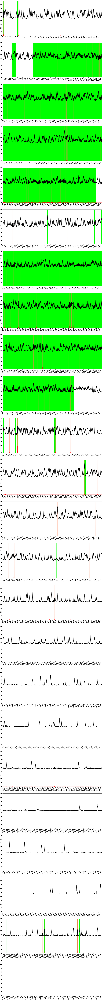

In [10]:
anorm=(d*5)**2
validate.figure(test_v, anorm, d, thr)